# 実習5-2
### VGG16で転移学習

In [0]:
import os
from keras.applications.vgg16 import VGG16 #これでVGG16実装が簡単に
from keras import backend as K
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential, Model
from keras.layers import Input, Activation, Dropout, Flatten, Dense
from keras import optimizers
import numpy as np
import time

/anaconda/envs/py35/lib/python3.5/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [0]:
import urllib.request 

url = "https://www.dropbox.com/s/w0w2uyl2vhhw76o/byori_dataset.zip?dl=1" # 保存したいファイルのURLを指定 (dropboxのURLを指定する際は、最後のdl=0をdl=1に設定する)
save_name = "byori_dataset.zip" # byori_dataset.zipという名前で保存される。
 
# ダウンロードを実行
urllib.request.urlretrieve(url, save_name)

('byori_dataset.zip', <http.client.HTTPMessage at 0x7f161a9e1240>)

In [0]:
#uploadしたzipファイルを解凍する
import zipfile
with zipfile.ZipFile("byori_dataset.zip","r") as zip_ref:
    zip_ref.extractall("") #""の中にはディレクトリのpathが入る

In [0]:
# 分類するクラス
classes = ['normal','tumor'] 
nb_classes = len(classes)

# 画像サイズ、batch数、epoch数
img_width, img_height = 200, 200
batch_size = 20
nb_epoch = 10

In [0]:
# トレーニング用とバリデーション用の画像格納先
train_data_dir = 'byori_dataset/train'
validation_data_dir = 'byori_dataset/validation'

# 今回はトレーニング用に1000枚、バリデーション用に300枚の画像を用意した。
nb_train_samples = 1000
nb_validation_samples = 300

result_dir = 'byori_dataset/results'
if not os.path.exists(result_dir):
    os.mkdir(result_dir)

In [0]:
# vgg16モデルを作る
def vgg_model_maker():
    # VGG16のロード。FC層は不要なので include_top=False
    # weights='imagenet', これでIMAGENETで学習済みの重みが使える。
    # input_tensorは自分で画像を用意する時に使う。画像サイズを指定。
    input_tensor = Input(shape=(img_width, img_height, 3))
    vgg16 = VGG16(include_top=False, weights='imagenet', input_tensor=input_tensor)

    # FC層を構築
    x = vgg16.output
    x = Flatten()(x)
    x = Dense(256, activation='relu')(x)
    x = Dropout(0.5)(x)
    predictions = Dense(nb_classes, activation='softmax')(x)

    
    # VGG16とFC層を接続
    model = Model(inputs=vgg16.input, outputs=predictions)
    
    return model

In [0]:
# ディレクトリ内の画像を読み込んでトレーニングデータとバリデーションデータの作成
def image_generator():
    train_datagen = ImageDataGenerator(
        rescale=1.0 / 255,
        zoom_range=0.2,
        horizontal_flip=True,
        vertical_flip=True)

    validation_datagen = ImageDataGenerator(rescale=1.0 / 255)

    train_generator = train_datagen.flow_from_directory(
        train_data_dir,
        target_size=(img_width, img_height),
        color_mode='rgb',
        classes=classes,
        class_mode='categorical',
        batch_size=batch_size,
        shuffle=True)

    validation_generator = validation_datagen.flow_from_directory(
        validation_data_dir,
        target_size=(img_width, img_height),
        color_mode='rgb',
        classes=classes,
        class_mode='categorical',
        batch_size=batch_size,
        shuffle=True)

    return (train_generator, validation_generator)

In [0]:
# モデル作成
vgg_model = vgg_model_maker()

# 14層目までのモデル重みを固定、最後のconv層の直前までの層の重みをfreeze
for layer in vgg_model.layers[:15]:
    layer.trainable = False
        
vgg_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 200, 200, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 200, 200, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 200, 200, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 100, 100, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 100, 100, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 100, 100, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 50, 50, 128)       0         
__________

In [0]:
# 多クラス分類を指定
vgg_model.compile(loss='categorical_crossentropy',
                  optimizer=optimizers.SGD(lr=1e-3, momentum=0.9),
                  metrics=['accuracy'])

# 画像のジェネレータ生成
train_generator, validation_generator = image_generator()
    
#vgg_model.load_weights('dataset/results/finetuning.h5')
    
start = time.time()
# Fine-tuning
hist = vgg_model.fit_generator(
    train_generator,
    steps_per_epoch = nb_train_samples/batch_size,
    validation_steps = nb_validation_samples/batch_size,
    nb_epoch = nb_epoch,
    validation_data = validation_generator)

vgg_model.save_weights(os.path.join(result_dir, 'finetuning.h5'))

process_time = (time.time() - start) / 60
print(u'学習終了。かかった時間は', process_time, u'分です。')

Found 2000 images belonging to 2 classes.
Found 600 images belonging to 2 classes.
Instructions for updating:
Use tf.cast instead.


/anaconda/envs/py35/lib/python3.5/site-packages/ipykernel/__main__.py:18: UserWarning: The semantics of the Keras 2 argument `steps_per_epoch` is not the same as the Keras 1 argument `samples_per_epoch`. `steps_per_epoch` is the number of batches to draw from the generator at each epoch. Basically steps_per_epoch = samples_per_epoch/batch_size. Similarly `nb_val_samples`->`validation_steps` and `val_samples`->`steps` arguments have changed. Update your method calls accordingly.
/anaconda/envs/py35/lib/python3.5/site-packages/ipykernel/__main__.py:18: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<keras_pre..., validation_data=<keras_pre..., validation_steps=15.0, steps_per_epoch=50.0, epochs=10)`


Epoch 1/10
50/50 [==============================] - 20s 398ms/step - loss: 0.2286 - acc: 0.9160 - val_loss: 0.4841 - val_acc: 0.8533
Epoch 2/10
50/50 [==============================] - 16s 320ms/step - loss: 0.0511 - acc: 0.9890 - val_loss: 0.1801 - val_acc: 0.9300
Epoch 3/10
50/50 [==============================] - 16s 319ms/step - loss: 0.0589 - acc: 0.9800 - val_loss: 0.2352 - val_acc: 0.9200
Epoch 4/10
50/50 [==============================] - 16s 320ms/step - loss: 0.0404 - acc: 0.9910 - val_loss: 0.1564 - val_acc: 0.9433
Epoch 5/10
50/50 [==============================] - 16s 322ms/step - loss: 0.0172 - acc: 0.9960 - val_loss: 0.3118 - val_acc: 0.9000
Epoch 6/10
50/50 [==============================] - 16s 320ms/step - loss: 0.0415 - acc: 0.9900 - val_loss: 0.1468 - val_acc: 0.9433
Epoch 7/10
50/50 [==============================] - 16s 321ms/step - loss: 0.0214 - acc: 0.9940 - val_loss: 0.3084 - val_acc: 0.9067
Epoch 8/10
50/50 [==============================] - 16s 321ms/step - 

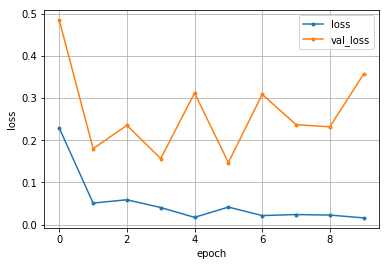

In [0]:
import matplotlib.pyplot as plt
%matplotlib inline

loss = hist.history['loss']
val_loss = hist.history['val_loss']

# lossのグラフ
plt.plot(range(nb_epoch), loss, marker='.', label='loss')
plt.plot(range(nb_epoch), val_loss, marker='.', label='val_loss')
plt.legend(loc='best', fontsize=10)
plt.grid()
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show()

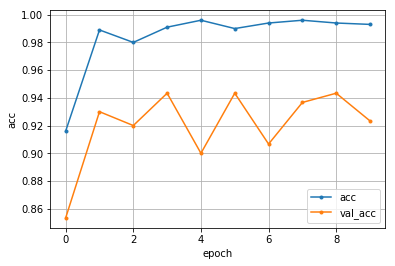

In [0]:
acc = hist.history['acc']
val_acc = hist.history['val_acc']

# accuracyのグラフ
plt.plot(range(nb_epoch), acc, marker='.', label='acc')
plt.plot(range(nb_epoch), val_acc, marker='.', label='val_acc')
plt.legend(loc='best', fontsize=10)
plt.grid()
plt.xlabel('epoch')
plt.ylabel('acc')
plt.show()

In [0]:
#Plotlyを使用してプロットしてみる。

import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls

##データの元を作る,複数書きたい場合はこれを繰り返す
trace  = go.Scatter(y = hist.history['val_acc'],
                    x=np.arange(1,201) ,
                    name = 'val_acc',
                    mode = 'lines')
trace1 = go.Scatter(y = hist.history['val_loss'],
                    x=np.arange(1,201) ,
                    name = 'val_loss',
                    mode = 'lines')

data = [trace,trace1]


##データのレイアウトを決める
layout = go.Layout(
    title='Fine-Tuning cancer or normal',
    legend={"x":0.8, "y":0.5},#legendそのままにしたいならshowlegend = True

    xaxis={"title":"epoch"},#軸の最大値最小値を決めたいならここに"range": [最小値,最大値]のように記入
    yaxis={"title":"accuracy"}
)

##データをプロット
fig = go.Figure(data=data, layout=layout)
py.iplot(fig,show_link = False)#グラフ表示のExport to plotly を消すにはここにshow_link=Falseのように記入


In [0]:
#＜＜スレットスコアを表示してみる＞＞

from keras.models import load_model
from keras.preprocessing.image import img_to_array, load_img

def normalization(data):
    data = data.astype("float32")
    data = data / 255.0
    return data

X = []
Y = []
file_path_list = []

#validation画像の読み込み
predict_dir = 'byori_dataset/validation/tumor/'
for picture in os.listdir(predict_dir):
        file_path_list.append(os.getcwd()+'/byori_dataset/validation/tumor/' + picture)
        # 画像の読み込み
        img = load_img(os.getcwd()+'/byori_dataset/validation/tumor/' + picture, target_size=(200, 200))
        img = img_to_array(img)
        X.append(img)
# Numpy の array に変換
X = np.asarray(X)
#   正規化
X = normalization(X)

predict_dir = 'byori_dataset/validation/normal/'
for picture in os.listdir(predict_dir):
        file_path_list.append(os.getcwd()+'/byori_dataset/validation/normal/' + picture)
        # 画像の読み込み
        img = load_img(os.getcwd()+'/byori_dataset/validation/normal/' + picture, target_size=(200, 200))
        img = img_to_array(img)
        Y.append(img)
# Numpy の array に変換
Y = np.asarray(Y)
#   正規化
Y = normalization(Y)


TP = 0
FP = 0
FN = 0
TN = 0
TPlist = []
TNlist = []
FPlist = []
FNlist = []

# 予測（分類）
predict_tum = vgg_model.predict(X)
predict_nor = vgg_model.predict(Y)

#スレットスコアを求める
for i, pre in enumerate(predict_tum):
    idx = np.argmax(pre)
    rate = pre[idx] * 100
    if classes[idx]=='tumor':
        TP += 1
        TPlist.append(file_path_list[i])

    else:
        FN += 1
        FNlist.append(file_path_list[i])

for i, pre in enumerate(predict_nor):
    idx = np.argmax(pre)
    rate = pre[idx] * 100     
    if classes[idx]=='normal':
        TN += 1
        TNlist.append(file_path_list[i])
    else:
        FP+=1
        FPlist.append(file_path_list[i])

In [0]:
#各値を表示
print(X.shape, Y.shape)
print((TP+TN)/(TP+TN+FP+FN)) #正答率
print(TP,FP,FN,TN)

(300, 200, 200, 3) (300, 200, 200, 3)
0.9233333333333333
266 12 34 288


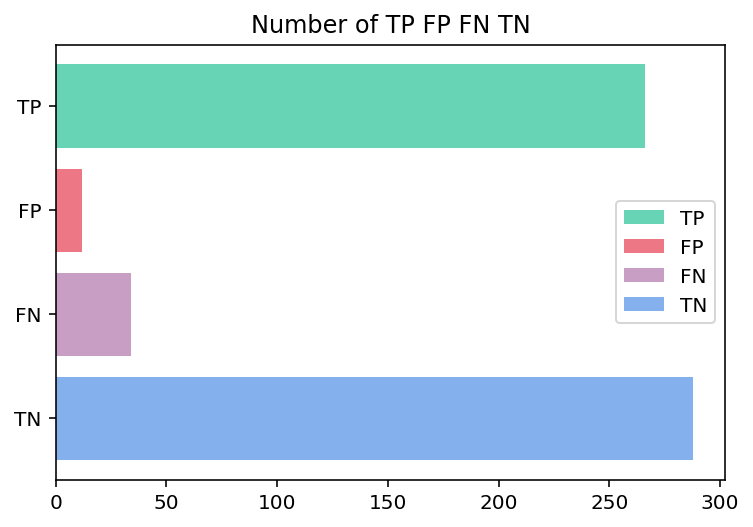

In [0]:
#スレットスコアを図として表示
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'retina' #matplotlibのグラフをRetinaの高解像度で表示する
%matplotlib inline
plt.barh(4,TP,label = 'TP',color = '#67D5B5')
plt.barh(3,FP,label = 'FP',color ='#EE7785')
plt.barh(2,FN,label = 'FN',color = '#C89EC4')
plt.barh(1,TN,label = 'TN',color ='#84B1ED')
plt.legend()
plt.yticks([4,3,2,1],['TP','FP','FN','TN'])
plt.title('Number of TP FP FN TN')
plt.savefig('dataset3TN,TP,FP,FN.jpeg',dpi = 1600)

Text(0.5,0.98,'block4_conv1')

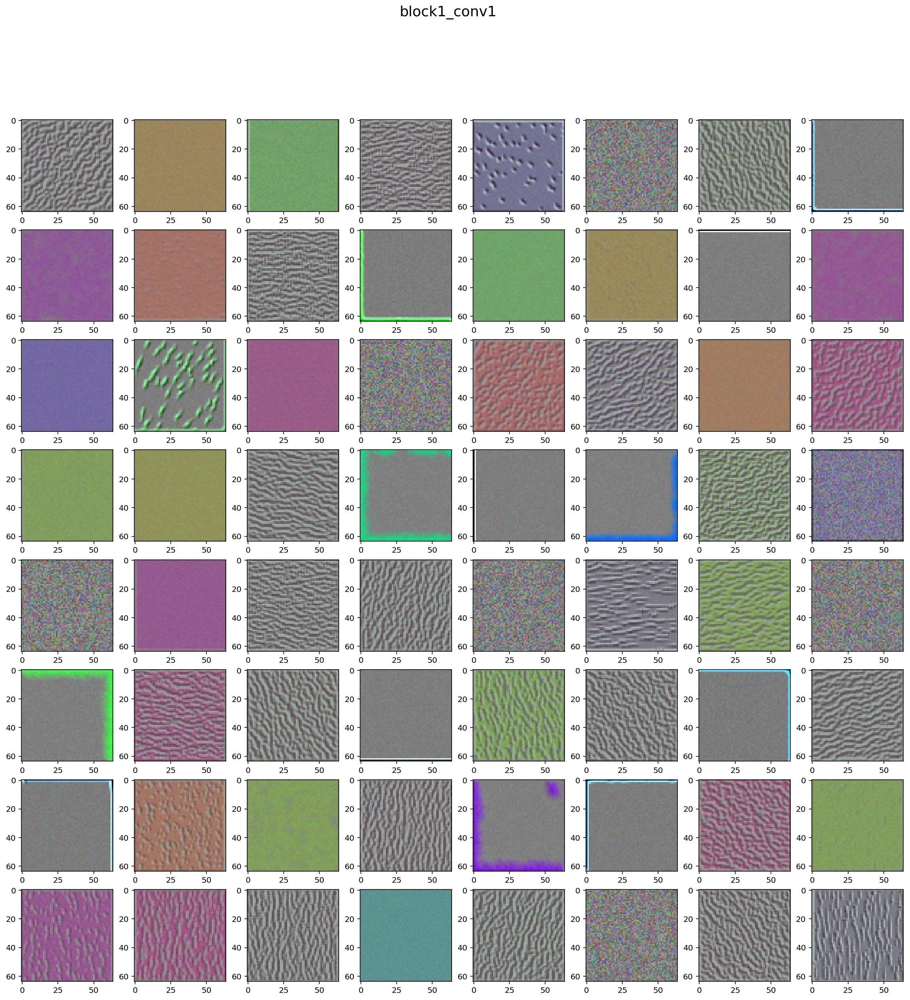

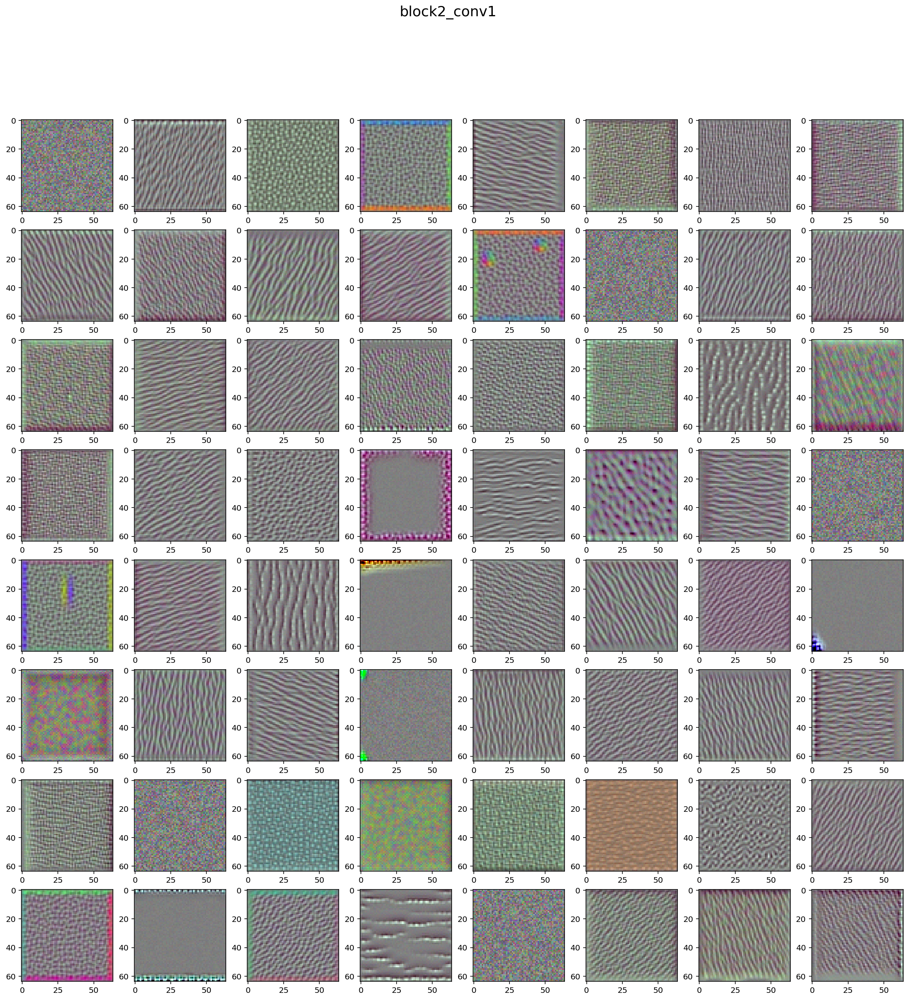

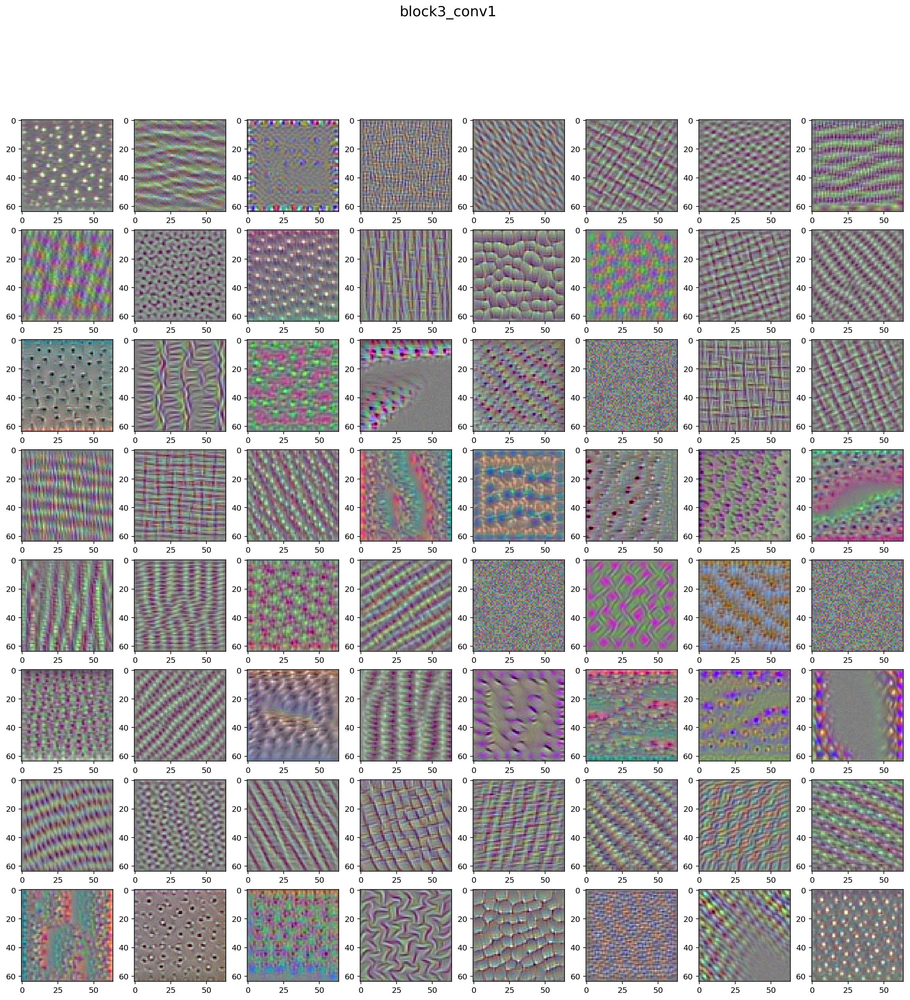

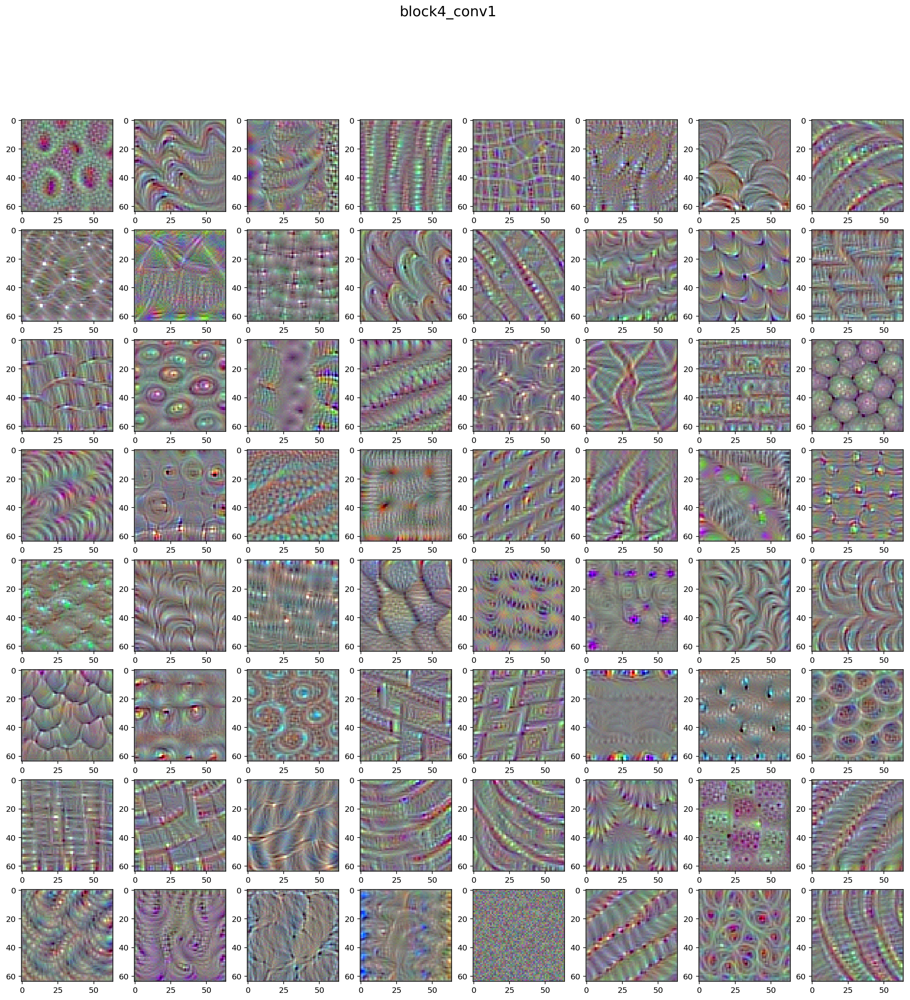

In [0]:
#＜＜フィルターに強く反応する画像の表示＞＞
# (書籍「pythonとKerasによるディープラーニング」５章より)
# (結構時間がかかります。)

def deprocess_image(x):
    # テンソルを正規化：中心を０、標準偏差を０.１にする
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # [0, 1]でクリッピング
    x += 0.5
    x = np.clip(x, 0, 1)

    # RGB配列に変換
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

def generate_pattern(layer_name, filter_index, size=200):
    # ターゲット層のn番目のフィルタの活性化を最大化する損失関数を構築
    layer_output = vgg_model.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])

    # この損失関数を使って入力画像の勾配を計算
    grads = K.gradients(loss, vgg_model.input)[0]

    # 正規化トリック：勾配を正規化
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

    # 入力画像に基づいて損失値と勾配値を返す関数
    iterate = K.function([vgg_model.input], [loss, grads])
    
    # 最初はノイズが含まれたグレースケール画像を使用
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.

    # 勾配上昇方を４０ステップ実行
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        
    img = input_img_data[0]
    return deprocess_image(img)

#各画像の表示
plt.figure(figsize = (20,20))
for i in range(64):
    plt.subplot(8,8,i+1)
    plt.imshow(generate_pattern('block1_conv1',i,size = 64))
plt.suptitle('block1_conv1',fontsize = 18)

plt.figure(figsize = (20,20))
for i in range(64):
    plt.subplot(8,8,i+1)
    plt.imshow(generate_pattern('block2_conv1',i,size = 64))
plt.suptitle('block2_conv1',fontsize = 18)

plt.figure(figsize = (20,20))
for i in range(64):
    plt.subplot(8,8,i+1)
    plt.imshow(generate_pattern('block3_conv1',i,size = 64))
plt.suptitle('block3_conv1',fontsize = 18)

plt.figure(figsize = (20,20))
for i in range(64):
    plt.subplot(8,8,i+1)
    plt.imshow(generate_pattern('block4_conv1',i,size = 64))
plt.suptitle('block4_conv1',fontsize = 18)

(1, 200, 200, 3)


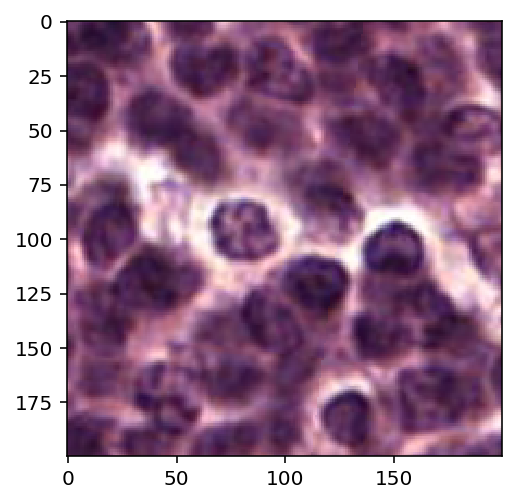

In [0]:
#＜＜中間層の出力を可視化する＞＞

img_path = 'byori_dataset/train/normal/Image00h1200w800.bmp'

# この画像を四次元テンソルとして前処理
from keras.preprocessing import image
import numpy as np

img = image.load_img(img_path, target_size=(200, 200))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)

# このモデルの訓練位しようされた入力が次の方法で前処理されていることに注意
img_tensor /= 255.

# Its shape is (1, ２００, ２００, ３)
print(img_tensor.shape)

#　画像の表示
import matplotlib.pyplot as plt
plt.imshow(img_tensor[0])
plt.show()

In [0]:
from keras import models

# 出力側の１８つの層から出力を抽出
layer_outputs = [layer.output for layer in vgg_model.layers[1:18]]
# 特定の入力をもとに、これらの出力を返すモデルを作成
activation_model = models.Model(inputs=vgg_model.input, outputs=layer_outputs)

# ５つのnumpy配列（そうの活性化ごとに１つ）のリストを返す
activations = activation_model.predict(img_tensor)

#　最初の畳み込み層の活性化後の出力
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 200, 200, 64)


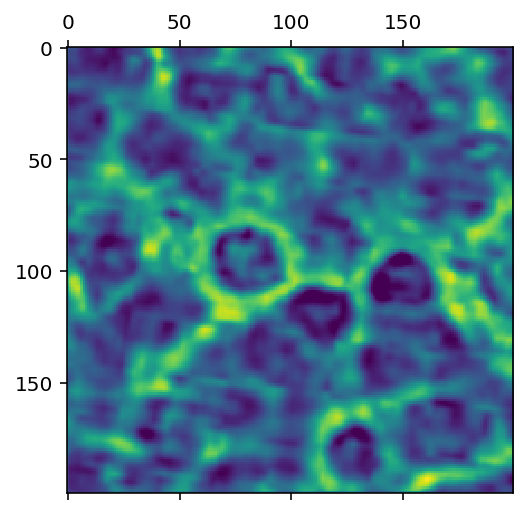

In [0]:
#　最初の畳み込み層の活性化後の出力の１番目のチャネルを表示
import matplotlib.pyplot as plt

plt.matshow(first_layer_activation[0, :, :, 1], cmap='viridis')
plt.show()

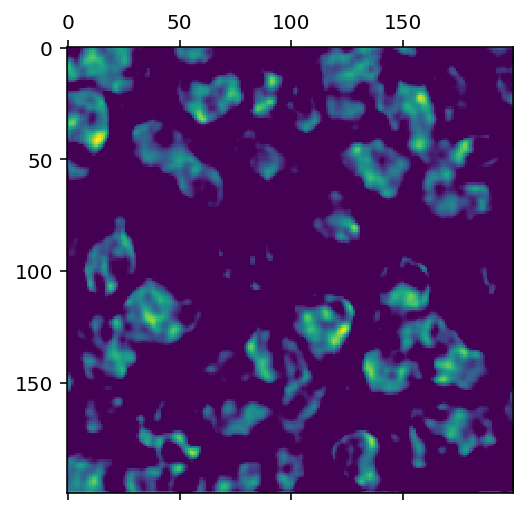

In [0]:
#　最初の畳み込み層の活性化後の出力の３９番目のチャネルを表示
plt.matshow(first_layer_activation[0, :, :, 39], cmap='viridis')
plt.show()

/anaconda/envs/py35/lib/python3.5/site-packages/ipykernel/__main__.py:31: RuntimeWarning:

invalid value encountered in true_divide



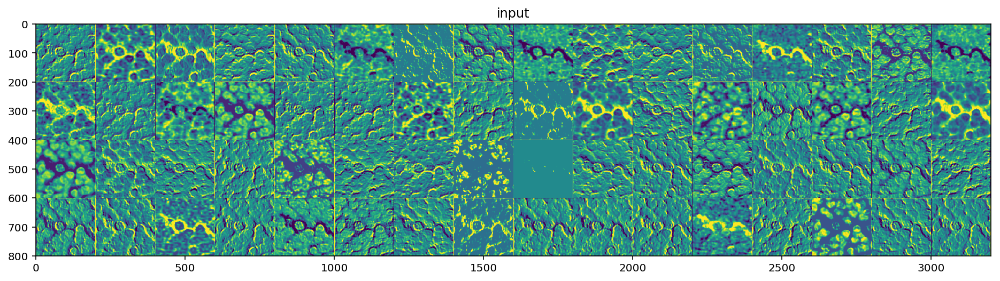

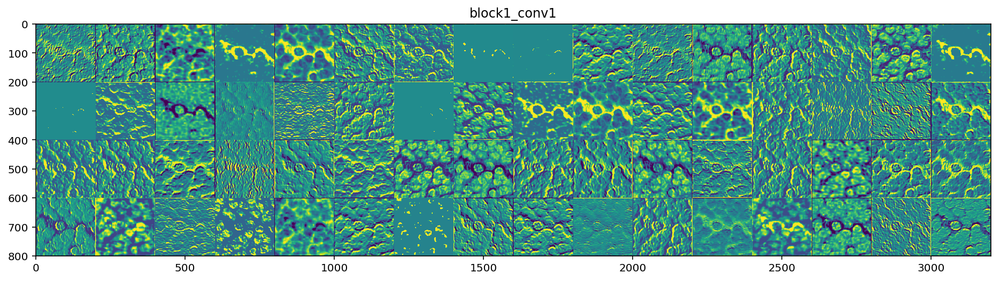

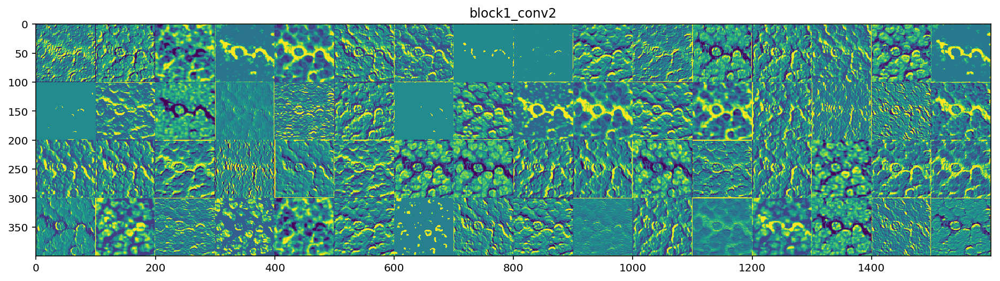

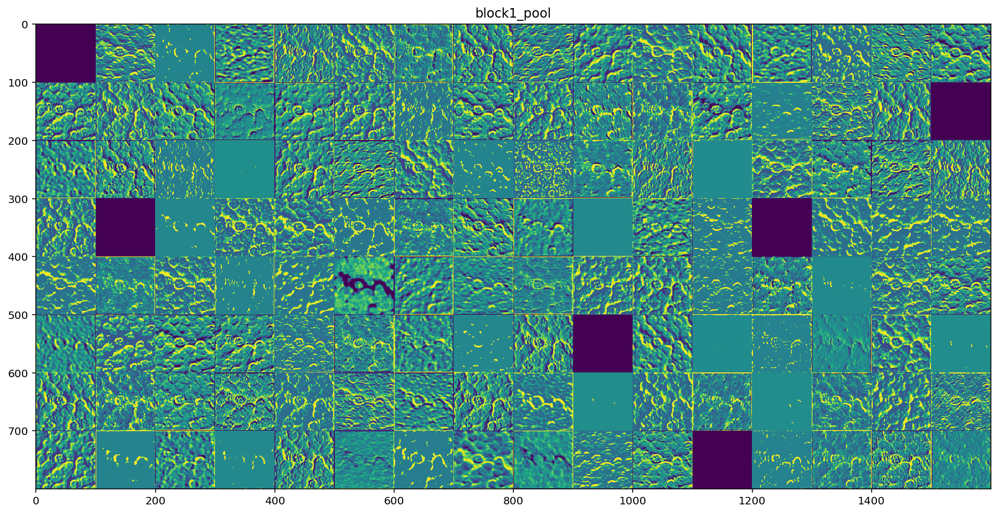

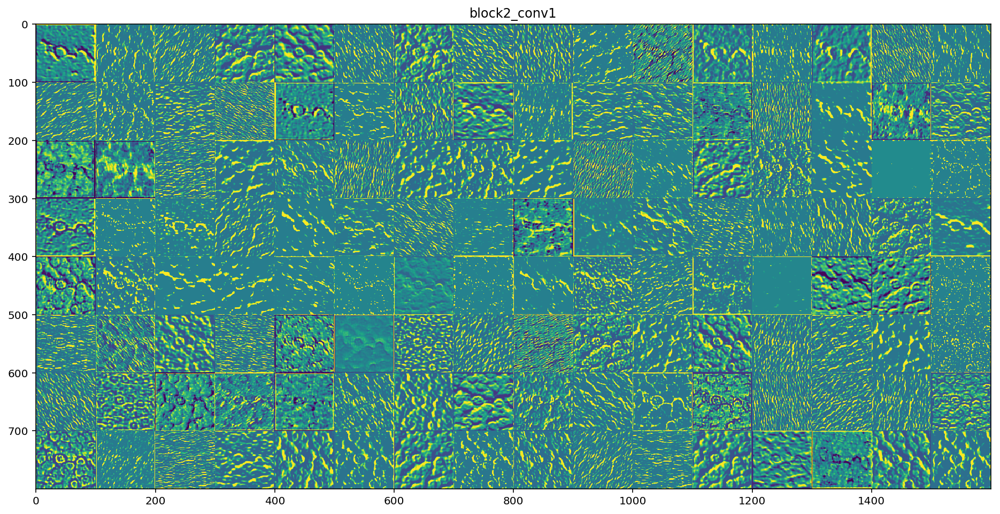

...

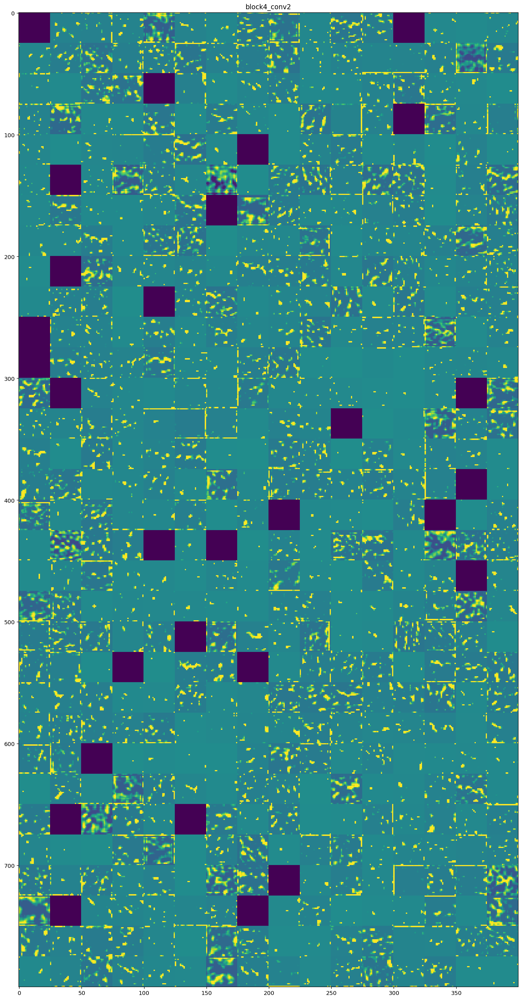

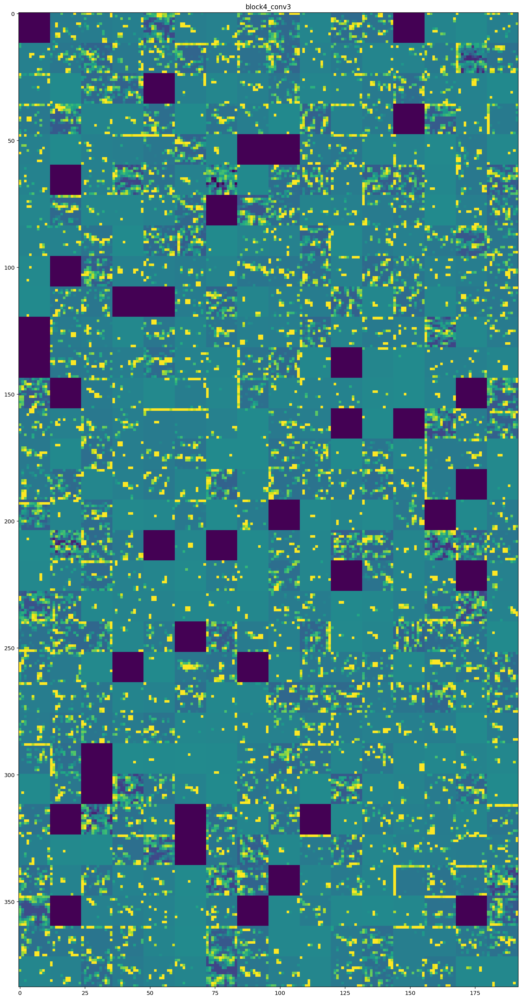

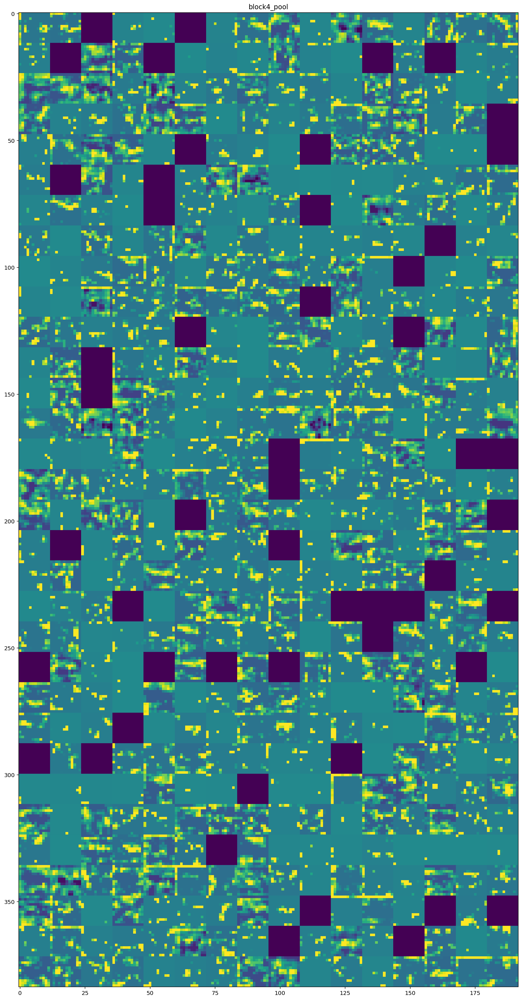

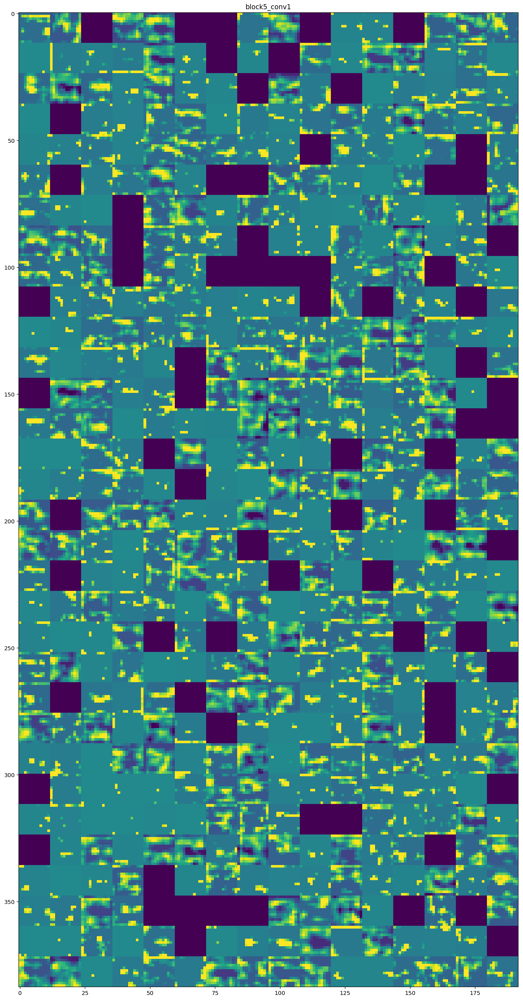

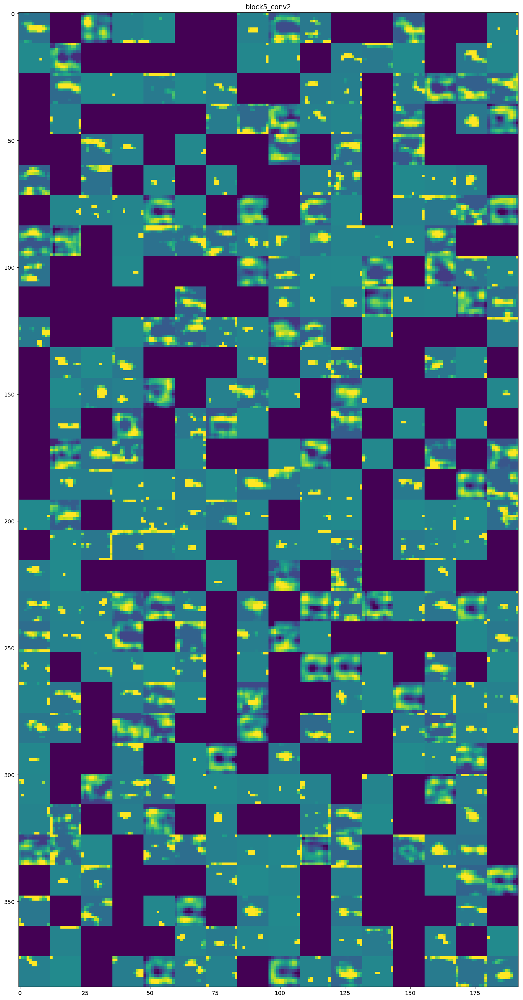

In [0]:
#　中間層の活性化ごとに全てのチャネルを可視化
import keras

# プロットの一部として使用する層の名前
layer_names = []
for layer in vgg_model.layers[:18]:
    layer_names.append(layer.name)

images_per_row = 16

# 特徴マップを表示する
for layer_name, layer_activation in zip(layer_names, activations):
    # 特徴マップに含まれている特徴量の数
    n_features = layer_activation.shape[-1]

    # 特徴マップの形状 (1, size, size, n_features)
    size = layer_activation.shape[1]

    # この行列で活性化のチャネルをタイル表示
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # 各フィルタを１つの大きな水平グリッドでタイル表示
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            # 特徴量の見た目を良くするための後処理
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    # グリッドを表示
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    if layer_name =='input_2':
        layer_name = layer_name[:-2]
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()

## 実習5-3 
#### Grad-CAMによるattention mapの作成
#### Deep Learningはブラックボックスであると言われているが、CNNでは画像のどこを判断基準にしたかがわかる
#### 詳細
(http://blog.brainpad.co.jp/entry/2017/07/10/163000)
#### 参考
(https://github.com/raghakot/keras-vis/blob/master/examples/vggnet/attention.ipynb)
#### Grad-CAMの論文
(https://arxiv.org/abs/1610.02391)

In [0]:
#keras-visのインストール, !をつけるとコマンドが実行できる。
#Keras-vis Documentation: https://raghakot.github.io/keras-vis/vis.visualization/
!pip install keras-vis

mxnet-model-server 1.0.1 requires model-archiver, which is not installed.
azure-datalake-store 0.0.41 has requirement requests>=2.20.0, but you'll have requests 2.18.4 which is incompatible.
chainermn 1.3.1 has requirement chainer<5.0,>=3.5.0, but you'll have chainer 5.2.0 which is incompatible.
autovizwidget 0.12.7 has requirement plotly<3.0,>=1.10.0, but you'll have plotly 3.6.1 which is incompatible.
flake8 3.7.5 has requirement pycodestyle<2.6.0,>=2.5.0, but you'll have pycodestyle 2.4.0 which is incompatible.
blobxfer 1.6.0 has requirement requests~=2.21.0, but you'll have requests 2.18.4 which is incompatible.
blobxfer 1.6.0 has requirement ruamel.yaml~=0.15.85, but you'll have ruamel-yaml 0.15.35 which is incompatible.
You are using pip version 19.1.1, however version 19.2.2 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [0]:
from vis.visualization import visualize_saliency, overlay
from vis.utils import utils
from keras import activations
from matplotlib import pyplot as plt
%matplotlib inline
plt.rcParams['figure.figsize'] = (18, 6)

/anaconda/envs/py35/lib/python3.5/site-packages/skimage/transform/_warps.py:84: UserWarning:

The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.



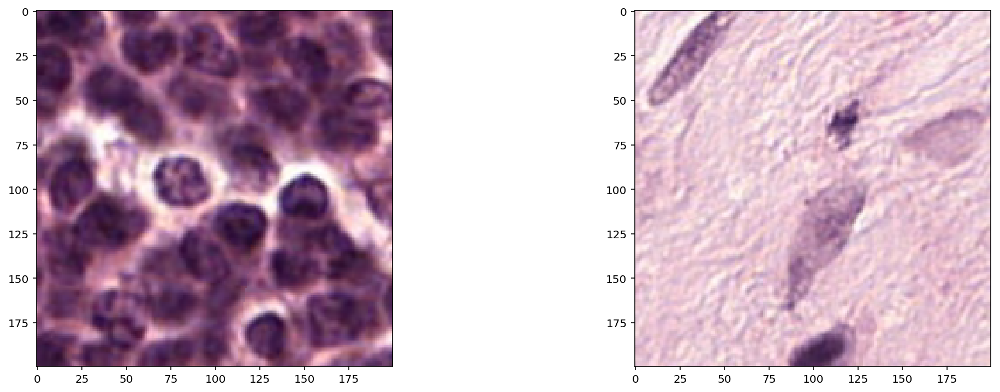

In [0]:
img1 = utils.load_img('byori_dataset/train/normal/Image00h1200w800.bmp', target_size=(200, 200))
img2 = utils.load_img('byori_dataset/train/tumor/Image03h1200w1200.bmp', target_size=(200, 200))
f, ax = plt.subplots(1, 2)
ax[0].imshow(img1)
ax[1].imshow(img2)

In [0]:
import numpy as np
import matplotlib.cm as cm
from vis.visualization import visualize_cam

layer_idx = utils.find_layer_idx(vgg_model, 'dense_4')

for modifier in [None, 'guided', 'relu']:
    plt.figure()
    f, ax = plt.subplots(1, 2)
    plt.suptitle("vanilla" if modifier is None else modifier)
    for i, img in enumerate([img1, img2]):    
        # 20 is the imagenet index corresponding to `ouzel`
        grads = visualize_cam(vgg_model, layer_idx, filter_indices=1, 
                              seed_input=img, backprop_modifier=modifier)        
        # Lets overlay the heatmap onto original image.    
        jet_heatmap = np.uint8(cm.jet(grads)[..., :3] * 255)
        ax[i].imshow(overlay(grads, img))

#### 細胞ではよくわからないので、イメージネットの重みをそのまま使ってみる。

In [0]:
from keras.applications import VGG16
from vis.utils import utils
from keras import activations
import matplotlib.pyplot as plt
%matplotlib inline

# VGG16モデルを作成し、imagenetの重みを入力
model = VGG16(weights='imagenet', include_top=True)
model.summary()
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.SGD(lr=1e-3, momentum=0.9),
              metrics=['accuracy'])

# Utility to search for layer index by name. 
# Alternatively we can specify this as -1 since it corresponds to the last layer.
layer_idx = utils.find_layer_idx(model, 'predictions')

# Swap softmax with linear
model.layers[layer_idx].activation = activations.linear
model = utils.apply_modifications(model)



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
__________

/Users/Niioka/anaconda/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/Niioka/anaconda/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


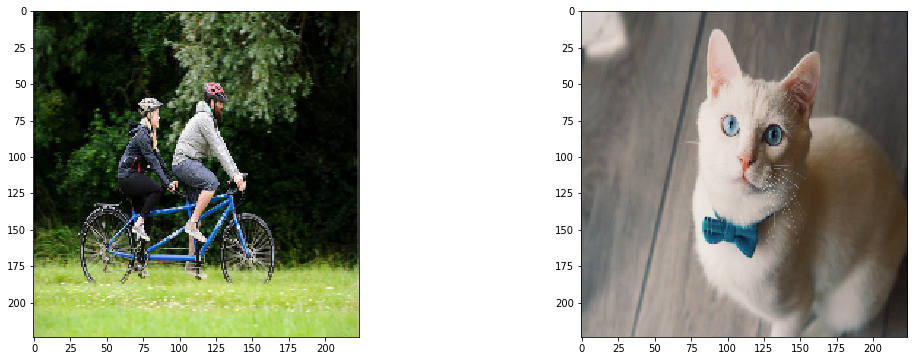

In [0]:
img1 = utils.load_img('tundem_bicycle.jpg', target_size=(224, 224))
img2 = utils.load_img('cat.jpg', target_size=(224, 224))
plt.rcParams['figure.figsize'] = (18, 6)
f, ax = plt.subplots(1, 2)
ax[0].imshow(img1)
ax[1].imshow(img2)

'\nImagenetのinex\nhttps://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a\n他の画像を用いて試してみましょう。\n'

<Figure size 1296x432 with 0 Axes>

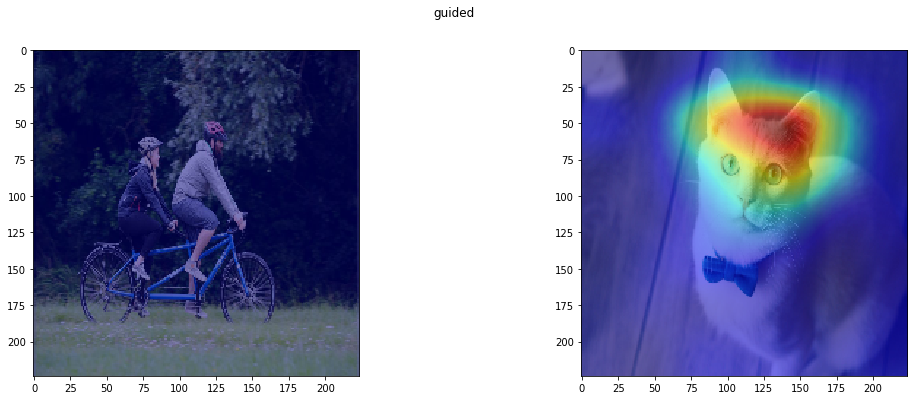

In [0]:
import numpy as np
import matplotlib.cm as cm
from vis.visualization import visualize_cam, overlay

modifier='guided'
plt.figure()
f, ax = plt.subplots(1, 2)
plt.suptitle("vanilla" if modifier is None else modifier)
for i, img in enumerate([img1, img2]):    

    # filter_indices = 285はEgyptian cat、444はtundem_bicycle
    grads = visualize_cam(model, layer_idx, filter_indices=285, 
                          seed_input=img, backprop_modifier=modifier)        
    # Lets overlay the heatmap onto original image.    
    jet_heatmap = np.uint8(cm.jet(grads)[..., :3] * 255)
    ax[i].imshow(overlay(grads, img))
    
"""
Imagenetのinex
https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
他の画像を用いてためしてみる
"""